<a href="https://colab.research.google.com/github/pixelbyteee/AQI_ANALYSIS/blob/main/AQI_Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import datetime
from warnings import filterwarnings
filterwarnings('ignore')


import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))
df_city_day = pd.read_csv('/content/city_day.csv')


In [ ]:
df_city_day.head()

,City,Date,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI,AQI_Bucket
0,Ahmedabad,2015-01-01,NaN,NaN,0.92,18.22,17.15,NaN,0.92,27.64,133.36,0.00,0.02,0.00,NaN,NaN
1,Ahmedabad,2015-01-02,NaN,NaN,0.97,15.69,16.46,NaN,0.97,24.55,34.06,3.68,5.50,3.77,NaN,NaN
2,Ahmedabad,2015-01-03,NaN,NaN,17.40,19.30,29.70,NaN,17.40,29.07,30.70,6.80,16.40,2.25,NaN,NaN
3,Ahmedabad,2015-01-04,NaN,NaN,1.70,18.48,17.97,NaN,1.70,18.59,36.08,4.43,10.14,1.00,NaN,NaN
4,Ahmedabad,2015-01-05,NaN,NaN,22.10,21.42,37.76,NaN,22.10,39.33,39.31,7.01,18.89,2.78,NaN,NaN


In [ ]:
df_city_day.shape

(29531, 16)

In [ ]:
df_city_day.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 29531 entries, 0 to 29530
Data columns (total 16 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   City        29531 non-null  object 
 1   Date        29531 non-null  object 
 2   PM2.5       24933 non-null  float64
 3   PM10        18391 non-null  float64
 4   NO          25949 non-null  float64
 5   NO2         25946 non-null  float64
 6   NOx         25346 non-null  float64
 7   NH3         19203 non-null  float64
 8   CO          27472 non-null  float64
 9   SO2         25677 non-null  float64
 10  O3          25509 non-null  float64
 11  Benzene     23908 non-null  float64
 12  Toluene     21490 non-null  float64
 13  Xylene      11422 non-null  float64
 14  AQI         24850 non-null  float64
 15  AQI_Bucket  24850 non-null  object 
dtypes: float64(13), object(3)
memory usage: 3.6+ MB


In [ ]:
df_city_day.describe().T

,count,mean,std,min,25%,50%,75%,max
PM2.5,24933.0,67.450578,64.661449,0.04,28.820,48.57,80.5900,949.99
PM10,18391.0,118.127103,90.605110,0.01,56.255,95.68,149.7450,1000.00
NO,25949.0,17.574730,22.785846,0.02,5.630,9.89,19.9500,390.68
NO2,25946.0,28.560659,24.474746,0.01,11.750,21.69,37.6200,362.21
NOx,25346.0,32.309123,31.646011,0.00,12.820,23.52,40.1275,467.63
NH3,19203.0,23.483476,25.684275,0.01,8.580,15.85,30.0200,352.89
CO,27472.0,2.248598,6.962884,0.00,0.510,0.89,1.4500,175.81
SO2,25677.0,14.531977,18.133775,0.01,5.670,9.16,15.2200,193.86
O3,25509.0,34.491430,21.694928,0.01,18.860,30.84,45.5700,257.73
Benzene,23908.0,3.280840,15.811136,0.00,0.120,1.07,3.0800,455.03


In [ ]:

def show_null_value(df):
    mis_val = df.isnull().sum()
    miss_val_percent= 100 * df.isna().sum()/ len(df)
    mis_val_table = pd.concat([mis_val, miss_val_percent], axis=1)
    mis_val_table_ren_columns = mis_val_table.rename(columns = {0 : 'Missing Values', 1 : '% of Total Values'})
    return mis_val_table_ren_columns

show_null_value(df_city_day)

,Missing Values,% of Total Values
City,0,0.000000
Date,0,0.000000
PM2.5,4598,15.570079
PM10,11140,37.723071
NO,3582,12.129626
NO2,3585,12.139785
NOx,4185,14.171549
NH3,10328,34.973418
CO,2059,6.972334
SO2,3854,13.050692


In [ ]:
df_city_day['Date'] = pd.to_datetime(df_city_day['Date'], format='%Y-%m-%d')
df_city_day = df_city_day.sort_values(by = 'Date')

In [ ]:
df_city_day['Date'].min() , df_city_day['Date'].max()

(Timestamp('2015-01-01 00:00:00'), Timestamp('2020-07-01 00:00:00'))

In [ ]:
df_city_day.columns

Index(['City', 'Date', 'PM2.5', 'PM10', 'NO', 'NO2', 'NOx', 'NH3', 'CO', 'SO2',
       'O3', 'Benzene', 'Toluene', 'Xylene', 'AQI', 'AQI_Bucket'],
      dtype='object')

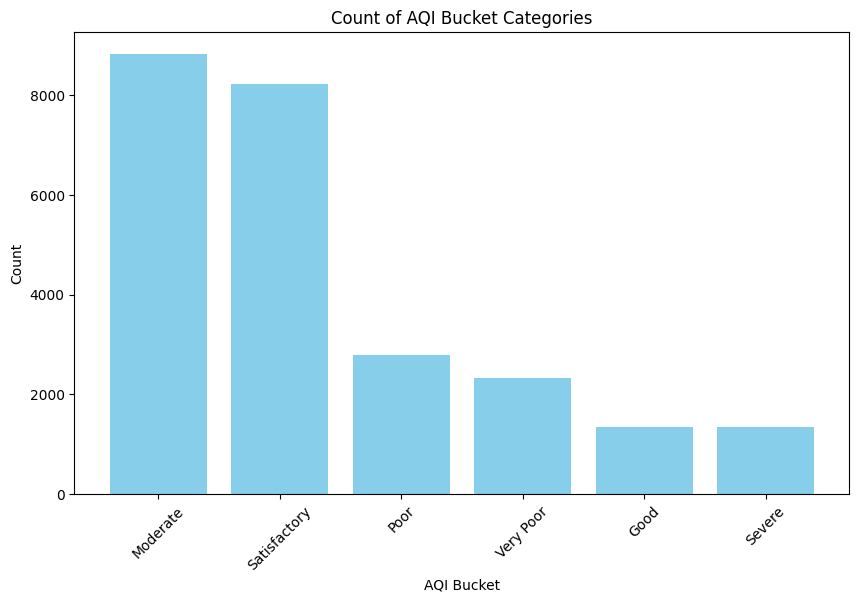

In [ ]:
import matplotlib.pyplot as plt

bucket_counts = df_city_day["AQI_Bucket"].value_counts()


plt.figure(figsize=(10, 6))
plt.bar(bucket_counts.index, bucket_counts.values, color="skyblue")
plt.xlabel("AQI Bucket")
plt.ylabel("Count")
plt.title("Count of AQI Bucket Categories")
plt.xticks(rotation=45)
plt.show()


In [ ]:
df_city_day = df_city_day.drop(["AQI_Bucket"], axis=1)

In [ ]:
df_city_day.head(2)

,City,Date,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI
0,Ahmedabad,2015-01-01,NaN,NaN,0.92,18.22,17.15,NaN,0.92,27.64,133.36,0.00,0.02,0.0,NaN
7834,Chennai,2015-01-01,NaN,NaN,16.30,15.39,22.68,4.59,1.17,9.20,11.35,0.17,NaN,NaN,NaN


In [ ]:
import plotly.express as px

# Melt the DataFrame to plot multiple columns in Plotly
df_melted = df_city_day[['PM2.5', 'PM10']].melt(var_name='Pollutant', value_name='Value')

# Plot
fig = px.box(df_melted, x="Pollutant", y="Value", title="Box Plot of PM2.5 and PM10")
fig.update_layout(xaxis_title="Pollutant", yaxis_title="Value")
fig.show()

In [ ]:
import plotly.express as px

df_melted = df_city_day[['NO', 'NO2', 'NOx', 'NH3']].melt(var_name='Pollutant', value_name='Value')
fig = px.box(df_melted, x="Pollutant", y="Value", title="Box Plot of NO, NO2, NOx, and NH3")
fig.update_layout(xaxis_title="Pollutant", yaxis_title="Value")
fig.show()


In [ ]:
import plotly.express as px


df_melted = df_city_day[['O3', 'CO', 'SO2']].melt(var_name='Pollutant', value_name='Value')


fig = px.box(df_melted, x="Pollutant", y="Value", title="Box Plot of O3, CO, and SO2")
fig.update_layout(xaxis_title="Pollutant", yaxis_title="Value")
fig.show()


In [ ]:
import plotly.express as px


df_melted = df_city_day[['Benzene', 'Toluene', 'Xylene']].melt(var_name='Pollutant', value_name='Value')

fig = px.box(df_melted, x="Pollutant", y="Value", title="Box Plot of Benzene, Toluene, and Xylene")
fig.update_layout(xaxis_title="Pollutant", yaxis_title="Value")
fig.show()


In [ ]:
def replace_outliers_with_quartiles(df):
    for column in df.select_dtypes(include=['number']).columns:
        Q1 = df[column].quantile(0.25)
        Q3 = df[column].quantile(0.75)
        IQR = Q3 - Q1

        # Calculate lower and upper bounds for identifying outliers
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR

        # Replace outliers with Q1 or Q3 using .loc
        df.loc[df[column] < lower_bound, column] = Q1
        df.loc[df[column] > upper_bound, column] = Q3

    return df

# Apply the function to the DataFrame
df_city_day = replace_outliers_with_quartiles(df_city_day)


In [ ]:
df_city_day.describe().T

,count,mean,min,25%,50%,75%,max,std
Date,29531,2018-05-14 05:40:15.807118080,2015-01-01 00:00:00,2017-04-16 00:00:00,2018-08-05 00:00:00,2019-09-03 00:00:00,2020-07-01 00:00:00,NaN
PM2.5,24933.0,54.975923,0.04,28.82,48.57,80.59,158.21,32.781561
PM10,18391.0,104.818086,0.01,56.255,95.68,149.7425,289.95,60.357602
NO,25949.0,12.472491,0.02,5.63,9.89,19.95,41.43,8.941774
NO2,25946.0,25.482607,0.01,11.75,21.69,37.62,76.4,16.698364
NOx,25346.0,26.520383,0.0,12.82,23.52,40.125625,81.06,17.876378
NH3,19203.0,19.661227,0.01,8.58,15.85,30.02,62.16,13.838362
CO,27472.0,0.952485,0.0,0.51,0.89,1.45,2.86,0.61346
SO2,25677.0,10.304869,0.01,5.67,9.16,15.22,29.54,5.908036
O3,25509.0,32.836577,0.01,18.86,30.84,45.57,85.63,17.969539


In [ ]:
import plotly.express as px

df_melted = df_city_day[['PM2.5', 'PM10']].melt(var_name='Pollutant', value_name='Value')


fig = px.box(df_melted, x="Pollutant", y="Value", title="Box Plot of PM2.5 and PM10")
fig.update_layout(xaxis_title="Pollutant", yaxis_title="Value")
fig.show()


In [ ]:
import plotly.express as px


df_melted = df_city_day[['NO', 'NO2', 'NOx', 'NH3']].melt(var_name='Pollutant', value_name='Value')


fig = px.box(df_melted, x="Pollutant", y="Value", title="Box Plot of NO, NO2, NOx, and NH3")
fig.update_layout(xaxis_title="Pollutant", yaxis_title="Value")
fig.show()


In [ ]:
import plotly.express as px

df_melted = df_city_day[['O3', 'CO', 'SO2']].melt(var_name='Pollutant', value_name='Value')


fig = px.box(df_melted, x="Pollutant", y="Value", title="Box Plot of O3, CO, and SO2")
fig.update_layout(xaxis_title="Pollutant", yaxis_title="Value")
fig.show()


In [ ]:
import plotly.express as px

df_melted = df_city_day[['Benzene', 'Toluene', 'Xylene']].melt(var_name='Pollutant', value_name='Value')

fig = px.box(df_melted, x="Pollutant", y="Value", title="Box Plot of Benzene, Toluene, and Xylene")
fig.update_layout(xaxis_title="Pollutant", yaxis_title="Value")
fig.show()


In [ ]:
df=df_city_day.drop(columns=['City'])

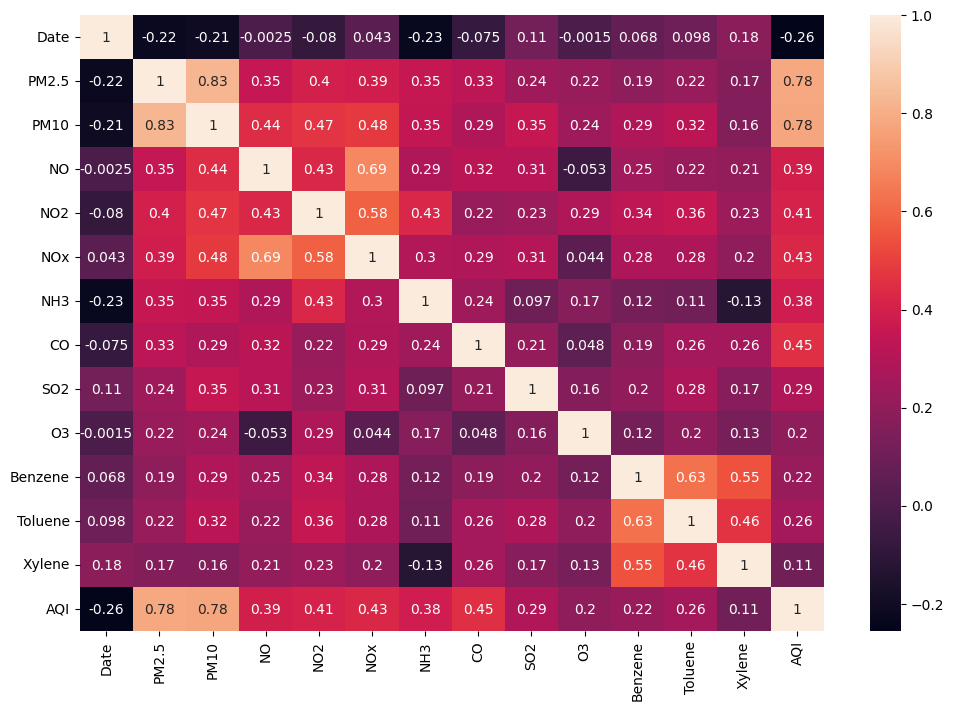

In [ ]:
plt.figure(figsize=(12, 8))
sns.heatmap(df.corr(),annot=True)
plt.show()

In [ ]:
df_full=df_city_day[df_city_day['AQI'].notna()]

In [ ]:
df_full['Year'] = df_full['Date'].dt.year

In [ ]:
df_full.head(2)

,City,Date,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI,Year
10229,Delhi,2015-01-01,80.59,149.745,19.95,36.39,40.1275,33.85,1.45,9.25,41.68,3.08,9.15,3.35,208.0,2015
10230,Delhi,2015-01-02,80.59,269.550,19.95,32.87,40.1275,31.83,1.45,6.65,29.97,3.08,20.09,4.29,208.0,2015


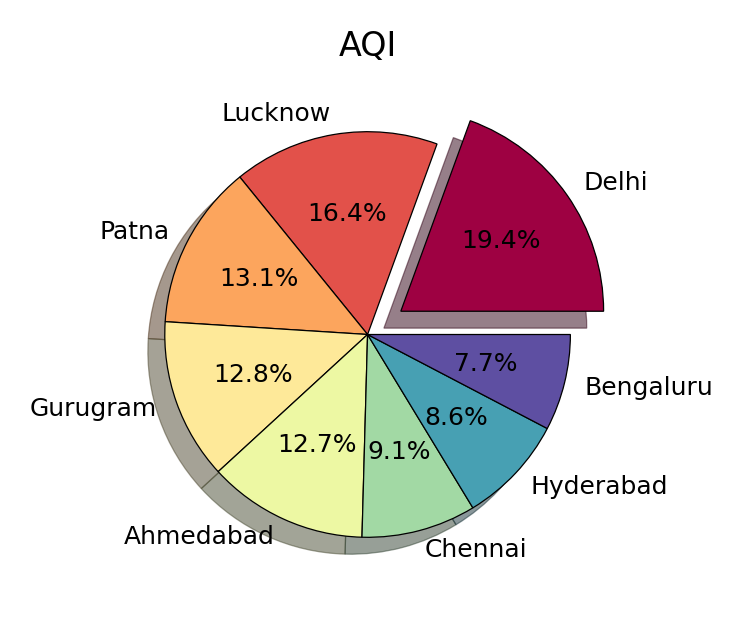

In [ ]:
cols = ['AQI']

cmap = plt.get_cmap('Spectral')
color = [cmap(i) for i in np.linspace(0, 1, 8)]
explode = [0.2, 0, 0, 0, 0, 0, 0, 0]

# Reduce figure size
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(8, 4), dpi=300)

axes = axes.flatten()

for ax, col in zip(axes, cols):
    # Group the cities and select the 8 cities with the highest total
    x = df_city_day.groupby('City')[col].sum().sort_values(ascending=False)
    x = x.reset_index('City')

    top_cities = x[:8]
    sizes = top_cities[col].values
    labels = top_cities['City'].tolist()

    # Create the pie chart
    wedges, texts, autotexts = ax.pie(sizes, shadow=True, autopct='%1.1f%%',
                                      colors=color, explode=explode,
                                      wedgeprops={'edgecolor': 'black', 'linewidth': 0.3},
                                      labels=labels)

    # Reduce label text size
    for text in texts:
        text.set_fontsize(6)

    # Reduce percentage text size
    for autotext in autotexts:
        autotext.set_fontsize(6)

    # Reduce title text size
    ax.set_title(f'{col}', fontsize=8)

# Remove unused axes
for i in range(len(cols), len(axes)):
    fig.delaxes(axes[i])

plt.tight_layout()
plt.show()


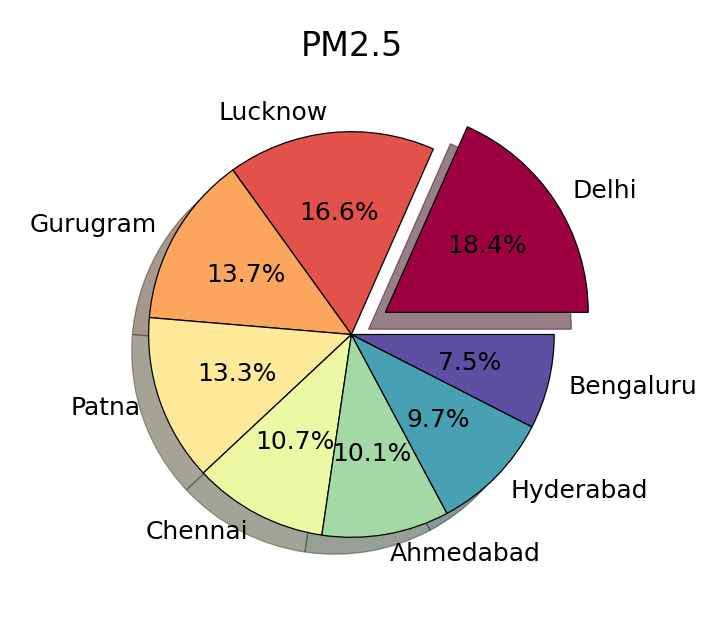

In [ ]:
cols = ['PM2.5']

cmap = plt.get_cmap('Spectral')
color = [cmap(i) for i in np.linspace(0, 1, 8)]
explode = [0.2, 0, 0, 0, 0, 0, 0, 0]

# Reduce figure size
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(8, 4), dpi=300)

axes = axes.flatten()

for ax, col in zip(axes, cols):
    # Group the cities and select the 8 cities with the highest total
    x = df_city_day.groupby('City')[col].sum().sort_values(ascending=False)
    x = x.reset_index('City')

    top_cities = x[:8]
    sizes = top_cities[col].values
    labels = top_cities['City'].tolist()

    # Create the pie chart
    wedges, texts, autotexts = ax.pie(sizes, shadow=True, autopct='%1.1f%%',
                                      colors=color, explode=explode,
                                      wedgeprops={'edgecolor': 'black', 'linewidth': 0.3},
                                      labels=labels)

    # Reduce label text size
    for text in texts:
        text.set_fontsize(6)

    # Reduce percentage text size
    for autotext in autotexts:
        autotext.set_fontsize(6)

    # Reduce title text size
    ax.set_title(f'{col}', fontsize=8)

# Remove unused axes
for i in range(len(cols), len(axes)):
    fig.delaxes(axes[i])

plt.tight_layout()
plt.show()


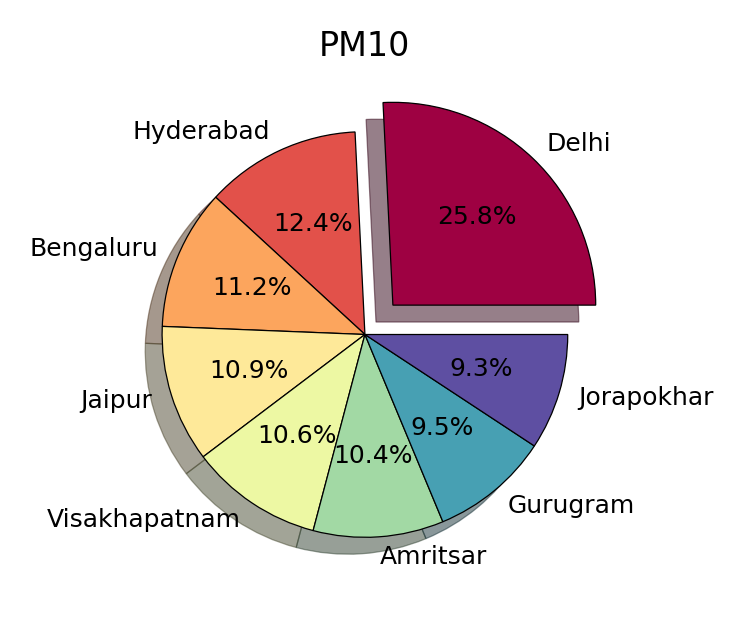

In [ ]:
cols = ['PM10']

cmap = plt.get_cmap('Spectral')
color = [cmap(i) for i in np.linspace(0, 1, 8)]
explode = [0.2, 0, 0, 0, 0, 0, 0, 0]

# Reduce figure size
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(8, 4), dpi=300)

axes = axes.flatten()

for ax, col in zip(axes, cols):
    # Group the cities and select the 8 cities with the highest total
    x = df_city_day.groupby('City')[col].sum().sort_values(ascending=False)
    x = x.reset_index('City')

    top_cities = x[:8]
    sizes = top_cities[col].values
    labels = top_cities['City'].tolist()

    # Create the pie chart
    wedges, texts, autotexts = ax.pie(sizes, shadow=True, autopct='%1.1f%%',
                                      colors=color, explode=explode,
                                      wedgeprops={'edgecolor': 'black', 'linewidth': 0.3},
                                      labels=labels)

    # Reduce label text size
    for text in texts:
        text.set_fontsize(6)

    # Reduce percentage text size
    for autotext in autotexts:
        autotext.set_fontsize(6)

    # Reduce title text size
    ax.set_title(f'{col}', fontsize=8)

# Remove unused axes
for i in range(len(cols), len(axes)):
    fig.delaxes(axes[i])

plt.tight_layout()
plt.show()


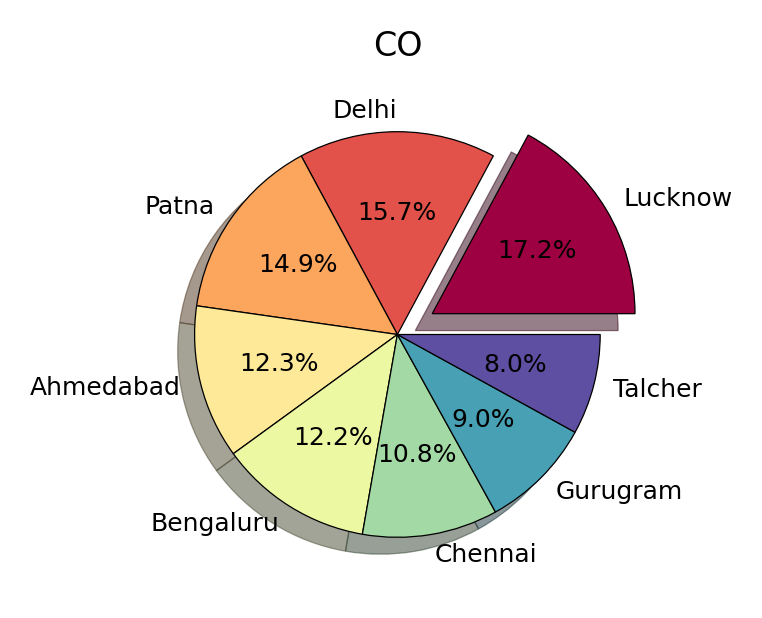

In [ ]:
cols = ['CO']

cmap = plt.get_cmap('Spectral')
color = [cmap(i) for i in np.linspace(0, 1, 8)]
explode = [0.2, 0, 0, 0, 0, 0, 0, 0]

# Reduce figure size
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(8, 4), dpi=300)

axes = axes.flatten()

for ax, col in zip(axes, cols):
    # Group the cities and select the 8 cities with the highest total
    x = df_city_day.groupby('City')[col].sum().sort_values(ascending=False)
    x = x.reset_index('City')

    top_cities = x[:8]
    sizes = top_cities[col].values
    labels = top_cities['City'].tolist()

    # Create the pie chart
    wedges, texts, autotexts = ax.pie(sizes, shadow=True, autopct='%1.1f%%',
                                      colors=color, explode=explode,
                                      wedgeprops={'edgecolor': 'black', 'linewidth': 0.3},
                                      labels=labels)

    # Reduce label text size
    for text in texts:
        text.set_fontsize(6)

    # Reduce percentage text size
    for autotext in autotexts:
        autotext.set_fontsize(6)

    # Reduce title text size
    ax.set_title(f'{col}', fontsize=8)

# Remove unused axes
for i in range(len(cols), len(axes)):
    fig.delaxes(axes[i])

plt.tight_layout()
plt.show()


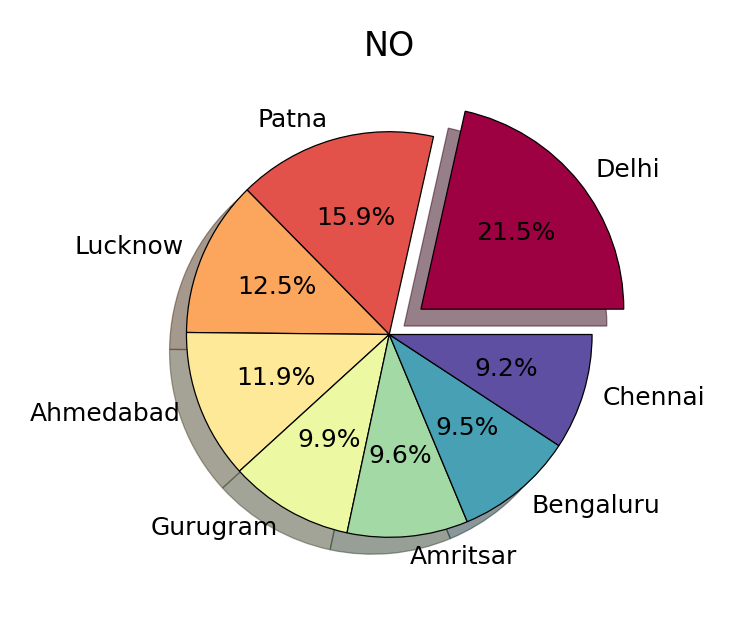

In [ ]:
cols = ['NO']

cmap = plt.get_cmap('Spectral')
color = [cmap(i) for i in np.linspace(0, 1, 8)]
explode = [0.2, 0, 0, 0, 0, 0, 0, 0]

# Reduce figure size
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(8, 4), dpi=300)

axes = axes.flatten()

for ax, col in zip(axes, cols):
    # Group the cities and select the 8 cities with the highest total
    x = df_city_day.groupby('City')[col].sum().sort_values(ascending=False)
    x = x.reset_index('City')

    top_cities = x[:8]
    sizes = top_cities[col].values
    labels = top_cities['City'].tolist()

    # Create the pie chart
    wedges, texts, autotexts = ax.pie(sizes, shadow=True, autopct='%1.1f%%',
                                      colors=color, explode=explode,
                                      wedgeprops={'edgecolor': 'black', 'linewidth': 0.3},
                                      labels=labels)

    # Reduce label text size
    for text in texts:
        text.set_fontsize(6)

    # Reduce percentage text size
    for autotext in autotexts:
        autotext.set_fontsize(6)

    # Reduce title text size
    ax.set_title(f'{col}', fontsize=8)

# Remove unused axes
for i in range(len(cols), len(axes)):
    fig.delaxes(axes[i])

plt.tight_layout()
plt.show()


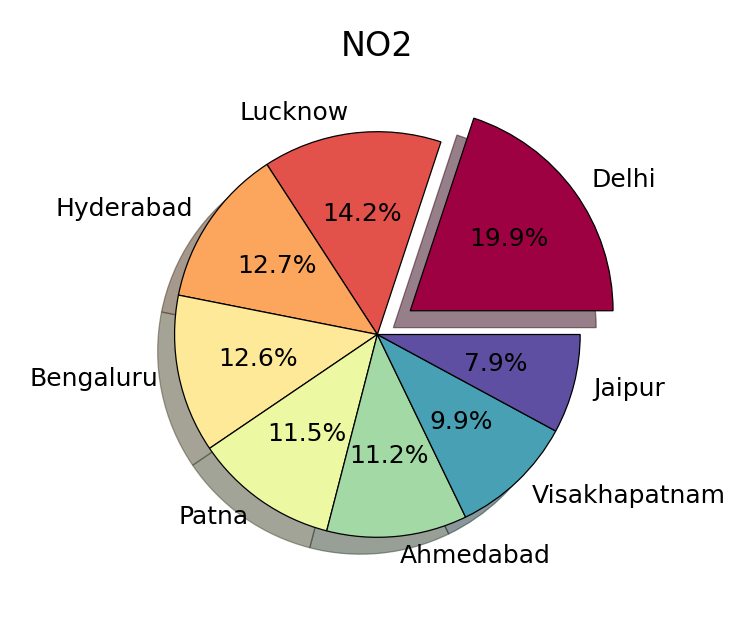

In [ ]:
cols = ['NO2']

cmap = plt.get_cmap('Spectral')
color = [cmap(i) for i in np.linspace(0, 1, 8)]
explode = [0.2, 0, 0, 0, 0, 0, 0, 0]

# Reduce figure size
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(8, 4), dpi=300)

axes = axes.flatten()

for ax, col in zip(axes, cols):
    # Group the cities and select the 8 cities with the highest total
    x = df_city_day.groupby('City')[col].sum().sort_values(ascending=False)
    x = x.reset_index('City')

    top_cities = x[:8]
    sizes = top_cities[col].values
    labels = top_cities['City'].tolist()

    # Create the pie chart
    wedges, texts, autotexts = ax.pie(sizes, shadow=True, autopct='%1.1f%%',
                                      colors=color, explode=explode,
                                      wedgeprops={'edgecolor': 'black', 'linewidth': 0.3},
                                      labels=labels)

    # Reduce label text size
    for text in texts:
        text.set_fontsize(6)

    # Reduce percentage text size
    for autotext in autotexts:
        autotext.set_fontsize(6)

    # Reduce title text size
    ax.set_title(f'{col}', fontsize=8)

# Remove unused axes
for i in range(len(cols), len(axes)):
    fig.delaxes(axes[i])

plt.tight_layout()
plt.show()


In [ ]:
numeric_cols = df_full.select_dtypes(include=np.number).columns.tolist()
numeric_cols

['PM2.5',
 'PM10',
 'NO',
 'NO2',
 'NOx',
 'NH3',
 'CO',
 'SO2',
 'O3',
 'Benzene',
 'Toluene',
 'Xylene',
 'AQI',
 'Year']

In [ ]:
categorical_cols = df_full.select_dtypes(include=['object']).columns.tolist()
categorical_cols

['City']

In [ ]:
full_columns=df_full.columns
full_columns

Index(['City', 'Date', 'PM2.5', 'PM10', 'NO', 'NO2', 'NOx', 'NH3', 'CO', 'SO2',
       'O3', 'Benzene', 'Toluene', 'Xylene', 'AQI', 'Year'],
      dtype='object')

In [ ]:
# We assigned to input_cols from full_columns, excluding the last column from index 0 and 2.
input_cols = [full_columns[0]]+list(full_columns[2:-2])+ [full_columns[-1]]
# We set the target column as AQI.
target_col = 'AQI'

In [ ]:
input_cols


['City',
 'PM2.5',
 'PM10',
 'NO',
 'NO2',
 'NOx',
 'NH3',
 'CO',
 'SO2',
 'O3',
 'Benzene',
 'Toluene',
 'Xylene',
 'Year']

In [ ]:
from sklearn.model_selection import train_test_split
train_and_val_df, test_df = train_test_split(df_full, test_size=0.2, random_state=42)
train_df, val_df = train_test_split(df_full, test_size=0.2)
print('train_df.shape :', train_df.shape)
print('val_df.shape :', val_df.shape)
print('test_df.shape :', test_df.shape)

train_df.shape : (19880, 16)
val_df.shape : (4970, 16)
test_df.shape : (4970, 16)


In [ ]:
train_df.head(2)


,City,Date,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI,Year
18266,Jorapokhar,2018-11-06,NaN,149.745,7.71,7.43,NaN,6.66,0.00,NaN,18.83,NaN,NaN,NaN,229.0,2018
10634,Delhi,2016-02-10,80.59,149.745,19.95,37.62,40.1275,48.24,2.02,21.61,45.57,3.08,9.15,NaN,368.0,2016


In [ ]:
val_df.head(2)

,City,Date,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI,Year
5922,Bengaluru,2019-06-17,25.77,64.03,8.35,21.68,25.92,13.23,0.70,8.36,30.6,1.28,2.92,NaN,61.0,2019
14942,Hyderabad,2015-12-31,80.59,98.01,28.46,25.50,52.22,10.46,1.73,14.74,25.9,2.33,13.33,2.05,213.0,2015


In [ ]:
test_df.head(2)

,City,Date,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI,Year
11286,Delhi,2017-11-23,80.59,251.23,34.73,55.04,70.15,40.03,1.55,18.32,54.34,4.53,11.97,0.1,340.0,2017
27868,Thiruvananthapuram,2019-12-14,17.89,42.06,8.57,14.27,14.52,9.53,1.30,8.33,32.31,NaN,NaN,NaN,78.0,2019


In [ ]:
train_inputs = train_df[input_cols].copy()# We copied the input_cols columns from the train_df DataFrame and assigned them to train_inputs
train_target = train_df[target_col].copy() # We copied the target_col columns from the train_df DataFrame and assigned them to train_target
val_inputs = val_df[input_cols].copy()
val_target = val_df[target_col].copy()
test_inputs = test_df[input_cols].copy()
test_target = test_df[target_col].copy()

In [ ]:
train_inputs.head(2)


,City,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,Year
18266,Jorapokhar,NaN,149.745,7.71,7.43,NaN,6.66,0.00,NaN,18.83,NaN,NaN,NaN,2018
10634,Delhi,80.59,149.745,19.95,37.62,40.1275,48.24,2.02,21.61,45.57,3.08,9.15,NaN,2016


In [ ]:
train_target

,AQI
18266,229.0
10634,368.0
19315,381.0
18676,168.0
18561,110.0
...,...
9842,92.0
4214,52.0
12556,346.0
18307,285.0


In [ ]:
numeric_cols = train_inputs.select_dtypes(include=np.number).columns.tolist()
categorical_cols = train_inputs.select_dtypes('object').columns.tolist()

In [ ]:
from sklearn.impute import SimpleImputer
imputer =  SimpleImputer(strategy = 'mean') # We created an imputer object and specified that it fills empty values ​​with the average.
imputer.fit(df_full[numeric_cols]) # df_full trains the imputer using the numeric columns in the DataFrame and calculates the mean values ​​for each column.

SimpleImputer()

In [ ]:
# The transform method transforms the missing values ​​in the training, test and validation sets using the mean values ​​learned with fit.
train_inputs[numeric_cols] = imputer.transform(train_inputs[numeric_cols])
val_inputs[numeric_cols] = imputer.transform(val_inputs[numeric_cols])
test_inputs[numeric_cols] = imputer.transform(test_inputs[numeric_cols])

In [ ]:
train_inputs[numeric_cols].isna().sum()

,0
PM2.5,0
PM10,0
NO,0
NO2,0
NOx,0
NH3,0
CO,0
SO2,0
O3,0
Benzene,0


In [ ]:
from sklearn.preprocessing import StandardScaler

In [ ]:
scaler = StandardScaler().fit(train_inputs[numeric_cols])# We created a scaler object and fit it with training data.
# Numerical columns in training, test and validation sets are standardized.
train_inputs[numeric_cols] = scaler.transform(train_inputs[numeric_cols])
val_inputs[numeric_cols] = scaler.transform(val_inputs[numeric_cols])
test_inputs[numeric_cols] = scaler.transform(test_inputs[numeric_cols])

In [ ]:
test_inputs.describe().T

,count,mean,std,min,25%,50%,75%,max
PM2.5,4970.0,0.004808,0.996110,-1.697250,-0.780876,-0.152893,0.763095,3.169618
PM10,4970.0,0.001361,1.001863,-2.058568,-0.663999,-0.000249,0.369085,3.594584
NO,4970.0,-0.006281,1.004046,-1.407403,-0.756234,-0.303908,0.725796,3.251050
NO2,4970.0,0.000573,1.000337,-1.551865,-0.833092,-0.188712,0.710620,3.046593
NOx,4970.0,-0.003044,0.998872,-1.570764,-0.748582,-0.066845,0.639909,3.172724
NH3,4970.0,0.014390,1.005277,-1.675476,-0.735954,-0.000757,0.436346,3.536895
CO,4970.0,0.007216,1.007108,-1.750386,-0.700508,-0.094977,0.776290,3.233265
SO2,4970.0,-0.011484,1.006122,-1.778078,-0.790635,-0.194019,0.798612,3.323422
O3,4970.0,-0.010927,0.985243,-1.874431,-0.771417,-0.074821,0.655006,2.961295
Benzene,4970.0,-0.001714,1.011613,-1.091137,-0.887624,-0.005512,0.632740,3.398125


In [ ]:
df_full[categorical_cols].nunique()

,0
City,26


In [ ]:
from sklearn.preprocessing import OneHotEncoder
# We created an encoder object. By default, sparse_output = True and the results are returned in a sparse format. If False is selected, a NumPy array is returned. handle_unknown = 'ignore' If unknown categories are encountered, no error is given and all zero values ​​are assigned for these categories.
encoder = OneHotEncoder(sparse_output = False, handle_unknown = 'ignore')
encoder.fit(df_full[categorical_cols])# We trained the encoder using the categorical columns in the df_full DataFrame.

OneHotEncoder(handle_unknown='ignore', sparse_output=False)

In [ ]:
encoder.categories_

[array(['Ahmedabad', 'Aizawl', 'Amaravati', 'Amritsar', 'Bengaluru',
        'Bhopal', 'Brajrajnagar', 'Chandigarh', 'Chennai', 'Coimbatore',
        'Delhi', 'Ernakulam', 'Gurugram', 'Guwahati', 'Hyderabad',
        'Jaipur', 'Jorapokhar', 'Kochi', 'Kolkata', 'Lucknow', 'Mumbai',
        'Patna', 'Shillong', 'Talcher', 'Thiruvananthapuram',
        'Visakhapatnam'], dtype=object)]

In [ ]:
# We converted the names of the one-hot encoded categorical columns created using the encoder object into a list.
encoded_cols = list(encoder.get_feature_names_out(categorical_cols))
encoded_cols

['City_Ahmedabad',
 'City_Aizawl',
 'City_Amaravati',
 'City_Amritsar',
 'City_Bengaluru',
 'City_Bhopal',
 'City_Brajrajnagar',
 'City_Chandigarh',
 'City_Chennai',
 'City_Coimbatore',
 'City_Delhi',
 'City_Ernakulam',
 'City_Gurugram',
 'City_Guwahati',
 'City_Hyderabad',
 'City_Jaipur',
 'City_Jorapokhar',
 'City_Kochi',
 'City_Kolkata',
 'City_Lucknow',
 'City_Mumbai',
 'City_Patna',
 'City_Shillong',
 'City_Talcher',
 'City_Thiruvananthapuram',
 'City_Visakhapatnam']

In [ ]:
train_inputs.head(2)

,City,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,Year
18266,Jorapokhar,-0.000334,0.868399,-0.542182,-1.107922,-0.003826,-1.120342,-1.750386,0.000829,-0.812144,-0.005512,-0.003626,-0.003071,-0.058918
10634,Delhi,0.783530,0.868399,0.836766,0.710620,0.777427,2.377002,1.769535,1.952070,0.700400,0.752453,0.899504,-0.003071,-1.413004


In [ ]:
# One-hot encodes categorical data and adds this encoded data to the dataset.
train_inputs[encoded_cols] = encoder.transform(train_inputs[categorical_cols])
val_inputs[encoded_cols] = encoder.transform(val_inputs[categorical_cols])
test_inputs[encoded_cols] = encoder.transform(test_inputs[categorical_cols])

In [ ]:
pd.set_option('display.max_columns', None)

In [ ]:
test_inputs.head(2)

,City,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,Year,City_Ahmedabad,City_Aizawl,City_Amaravati,City_Amritsar,City_Bengaluru,City_Bhopal,City_Brajrajnagar,City_Chandigarh,City_Chennai,City_Coimbatore,City_Delhi,City_Ernakulam,City_Gurugram,City_Guwahati,City_Hyderabad,City_Jaipur,City_Jorapokhar,City_Kochi,City_Kolkata,City_Lucknow,City_Mumbai,City_Patna,City_Shillong,City_Talcher,City_Thiruvananthapuram,City_Visakhapatnam
11286,Delhi,0.783530,2.852457,2.501867,1.759941,2.534290,1.686449,0.950544,1.383123,1.196473,1.620377,1.544735,-1.594027,-0.735961,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
27868,Thiruvananthapuram,-1.150386,-1.236870,-0.445295,-0.695904,-0.721079,-0.878943,0.514910,-0.344470,-0.049650,-0.005512,-0.003626,-0.003071,0.618125,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0


In [ ]:
from sklearn.linear_model import LinearRegression, Ridge, Lasso, ElasticNet, SGDRegressor
from sklearn.metrics import r2_score
from sklearn.ensemble import GradientBoostingRegressor, RandomForestRegressor
from sklearn.svm import SVR
from sklearn.tree import DecisionTreeRegressor, plot_tree
import xgboost as xgb
import statsmodels.api as sm


In [ ]:
X_train = train_inputs[numeric_cols + encoded_cols]
X_val = val_inputs[numeric_cols + encoded_cols]
X_test = test_inputs[numeric_cols + encoded_cols]

In [ ]:
def guess_mean(inputs):
    return np.full(len(inputs), df_full.AQI.mean())

In [ ]:
guess_mean_train_r2_score=r2_score(guess_mean(X_train), train_target)
print("The error was calculated by assigning average values ​​to the prediction train_r2score: ", guess_mean_train_r2_score)
guess_mean_val_r2_score=r2_score(guess_mean(X_val), val_target)
print("The error was calculated by assigning average values ​​to the prediction val_r2score : ", guess_mean_val_r2_score)
guess_mean_test_r2_score=r2_score(guess_mean(X_test), test_target)
print("The error was calculated by assigning average values ​​to the prediction test_r2score: ", guess_mean_test_r2_score)

The error was calculated by assigning average values ​​to the prediction train_r2score:  -9.462316173249166e+30
The error was calculated by assigning average values ​​to the prediction val_r2score :  0.0
The error was calculated by assigning average values ​​to the prediction test_r2score:  0.0


In [ ]:
def guess_random(inputs):
    lo, hi = df_full.AQI.min(), df_full.AQI.max()
    return np.random.random(len(inputs)) * (hi - lo) + lo

In [ ]:
guess_random_train_r2_score=r2_score(guess_random(X_train), train_target)
print("The error was calculated by assigning random values ​​to the prediction train_r2_score: ", guess_random_train_r2_score)
guess_random_val_r2_score=r2_score(guess_random(X_val), val_target)
print("The error was calculated by assigning random values ​​to the prediction val_r2_score : ", guess_random_val_r2_score)
guess_random_test_r2_score=r2_score(guess_random(X_test), test_target)
print("The error was calculated by assigning random values ​​to the prediction test_r2_score : ", guess_random_test_r2_score)

The error was calculated by assigning random values ​​to the prediction train_r2_score:  -0.910507112138397
The error was calculated by assigning random values ​​to the prediction val_r2_score :  -0.8855684096675542
The error was calculated by assigning random values ​​to the prediction test_r2_score :  -0.9121270556491319


In [ ]:
from sklearn.linear_model import LinearRegression, Ridge, SGDRegressor, ElasticNet, Lasso
from sklearn.svm import SVR
from sklearn.ensemble import GradientBoostingRegressor, RandomForestRegressor
import xgboost as xgb
import statsmodels.api as sm  # For Negative Binomial Regression
import lightgbm as lgb  # For LightGBM Regression

results = []
# Dictionary to hold model objects
models = {
    'LinearRegression': LinearRegression(),
    'Ridge': Ridge(),
    'SGDRegressor': SGDRegressor(),
    'ElasticNet': ElasticNet(),
    'Lasso': Lasso(),
    'SVR': SVR(kernel='linear'),
    'GradientBoostingRegressor': GradientBoostingRegressor(random_state=42),
    'XGBoost': xgb.XGBRegressor(random_state=42),  # XGBoost Regressor
    'RandomForestRegressor': RandomForestRegressor(random_state=42),  # Random Forest Regressor
    'LightGBM': lgb.LGBMRegressor(random_state=42)  # LightGBM Regressor
}


In [ ]:
def try_model(model,name):
    model.fit(X_train, train_target)
    train_preds = model.predict(X_train)
    val_preds = model.predict(X_val)
    test_preds=model.predict(X_test)

    # The R^2 score indicates how well the model predicted. A value close to 1 indicates that the model predicted perfectly.
    train_r2_score = r2_score(train_target, train_preds)
    val_r2_score= r2_score(val_target, val_preds)
    test_r2_score = r2_score(test_target, test_preds)

    print(f"{name} Model:")
    print("Train r2_score : ", train_r2_score)
    print("Validation r2_score : ", val_r2_score)
    print("Test r2_score : ", test_r2_score)
    print("-" * 40)
    # We add the name of each model and the scores of that model to the result list.
    results.append({'Model': name, 'Train R2 Score': train_r2_score, 'Validation R2 Score': val_r2_score, 'Test R2 Score': test_r2_score})

In [ ]:
for name, model in models.items():
    try_model(model,name)

LinearRegression Model:
Train r2_score :  0.7116587240794567
Validation r2_score :  0.7031240263955003
Test r2_score :  0.708504595842996
----------------------------------------
Ridge Model:
Train r2_score :  0.7116586606640574
Validation r2_score :  0.703125487237003
Test r2_score :  0.7085052260983002
----------------------------------------
SGDRegressor Model:
Train r2_score :  0.7102940547986114
Validation r2_score :  0.7014668020109887
Test r2_score :  0.7072555181956265
----------------------------------------
ElasticNet Model:
Train r2_score :  0.6441829028617343
Validation r2_score :  0.6327265433069857
Test r2_score :  0.6416360497323351
----------------------------------------
Lasso Model:
Train r2_score :  0.6906681230935661
Validation r2_score :  0.6842950211063347
Test r2_score :  0.689287867600552
----------------------------------------
SVR Model:
Train r2_score :  0.6867243988229198
Validation r2_score :  0.6783446646554412
Test r2_score :  0.6857127794278882
---------

In [ ]:
pip install lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 8.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283834 sha256=405b9512de11fc999e1ded98d9f9fd607c12423932f6b12dd75d5adae9177fe3
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime


LinearRegression Model:
Train R^2 Score: 0.712
Validation R^2 Score: 0.703
Test R^2 Score: 0.709
----------------------------------------
Computing SHAP values for LinearRegression...
Generating SHAP summary plot for LinearRegression...


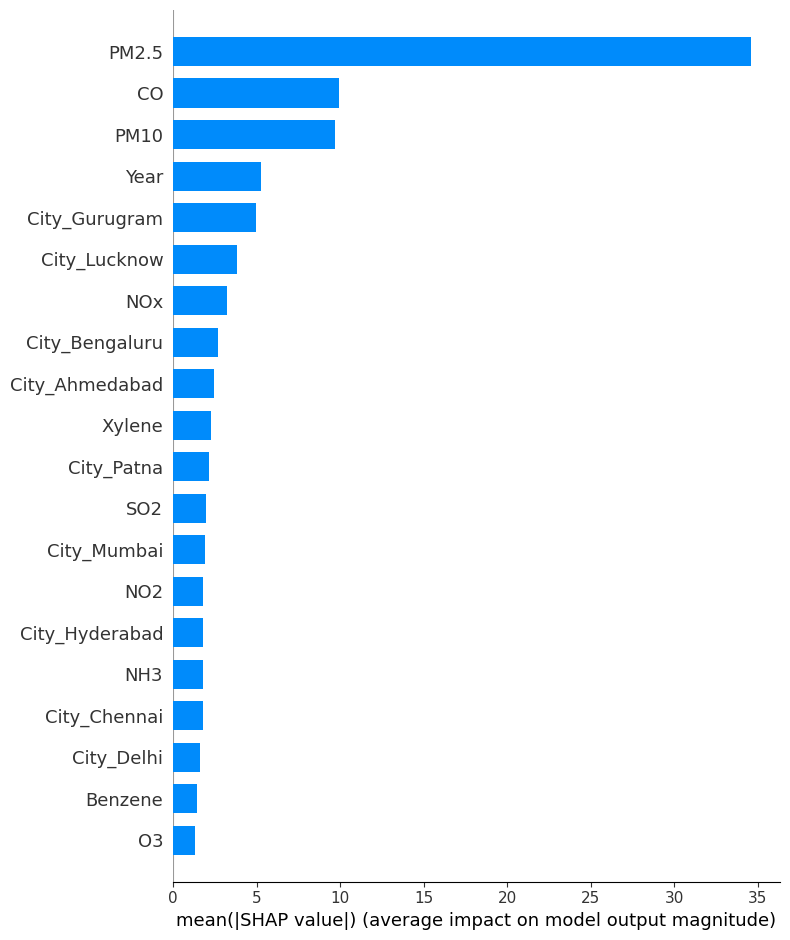

Computing LIME explanations for LinearRegression...
Generating LIME explanation for instance 0...


Ridge Model:
Train R^2 Score: 0.712
Validation R^2 Score: 0.703
Test R^2 Score: 0.709
----------------------------------------
Computing SHAP values for Ridge...
Generating SHAP summary plot for Ridge...


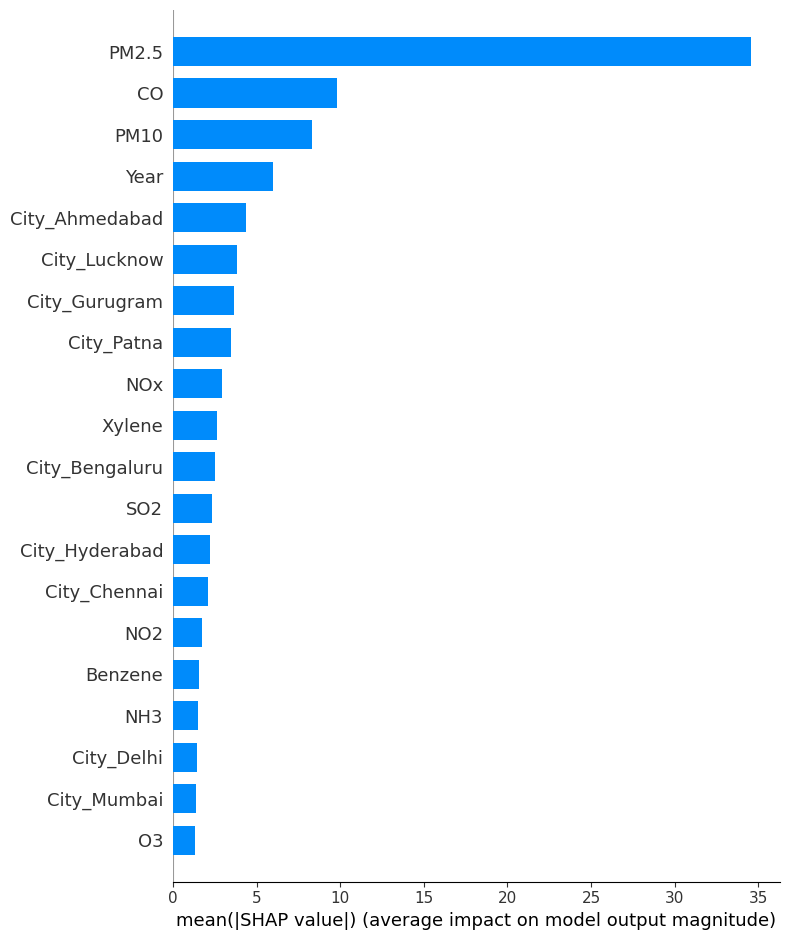

Computing LIME explanations for Ridge...
Generating LIME explanation for instance 0...


SGDRegressor Model:
Train R^2 Score: 0.711
Validation R^2 Score: 0.703
Test R^2 Score: 0.708
----------------------------------------
Computing SHAP values for SGDRegressor...
Generating SHAP summary plot for SGDRegressor...


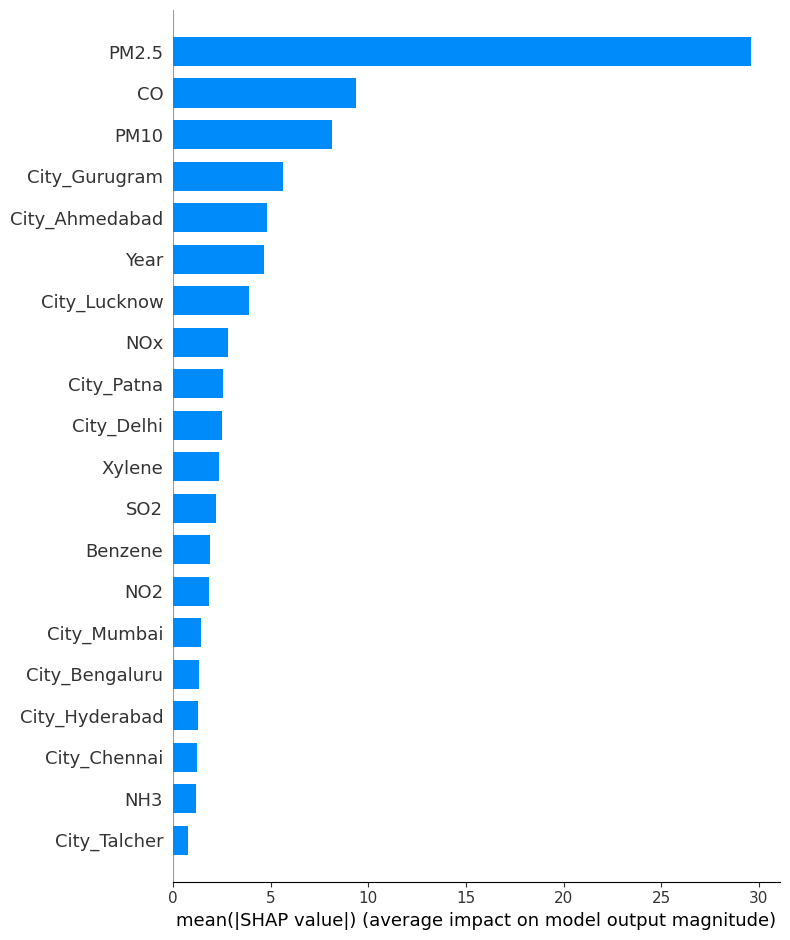

Computing LIME explanations for SGDRegressor...
Generating LIME explanation for instance 0...


ElasticNet Model:
Train R^2 Score: 0.644
Validation R^2 Score: 0.633
Test R^2 Score: 0.642
----------------------------------------
Computing SHAP values for ElasticNet...
Generating SHAP summary plot for ElasticNet...


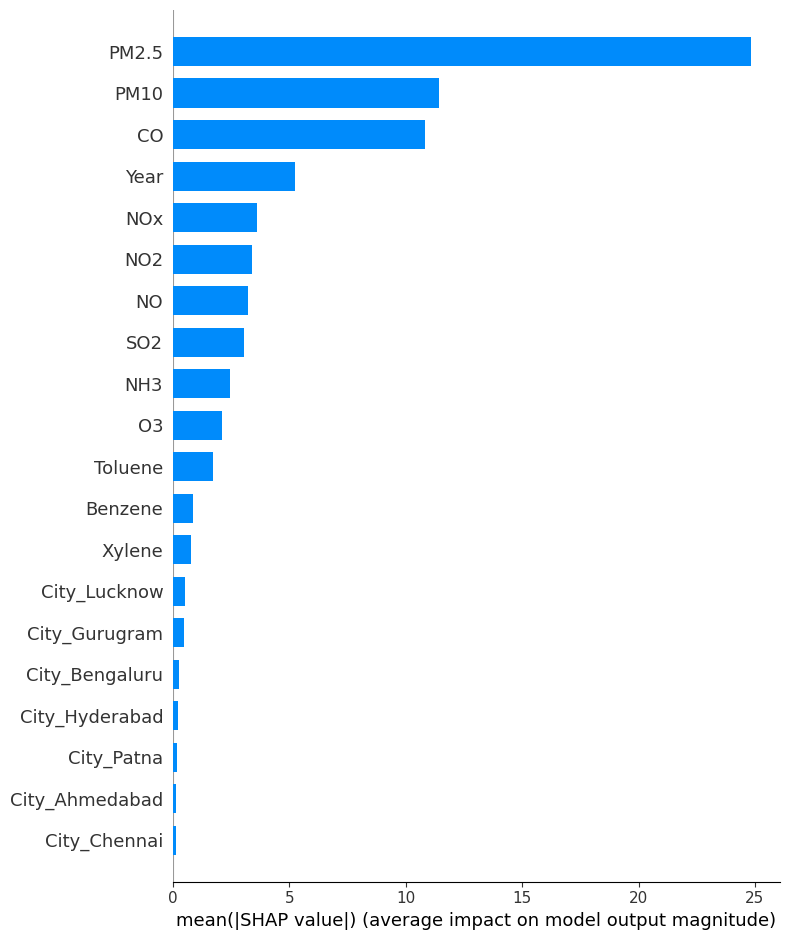

Computing LIME explanations for ElasticNet...
Generating LIME explanation for instance 0...


Lasso Model:
Train R^2 Score: 0.691
Validation R^2 Score: 0.684
Test R^2 Score: 0.689
----------------------------------------
Computing SHAP values for Lasso...
Generating SHAP summary plot for Lasso...


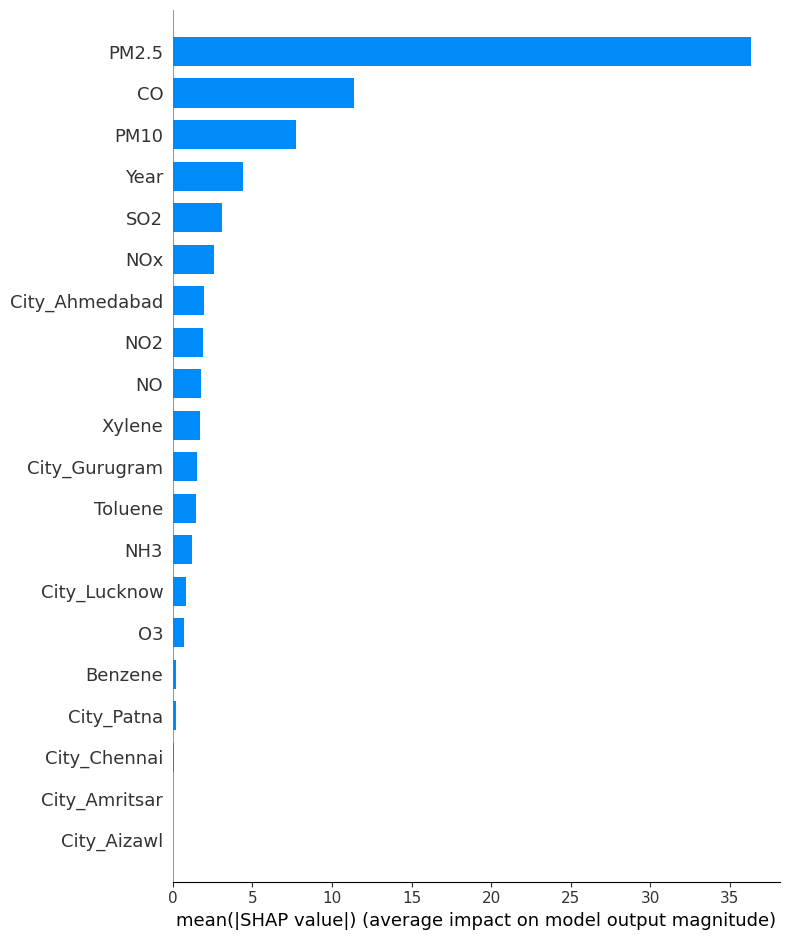

Computing LIME explanations for Lasso...
Generating LIME explanation for instance 0...


SVR Model:
Train R^2 Score: 0.687
Validation R^2 Score: 0.678
Test R^2 Score: 0.686
----------------------------------------
Computing SHAP values for SVR...
Generating SHAP summary plot for SVR...


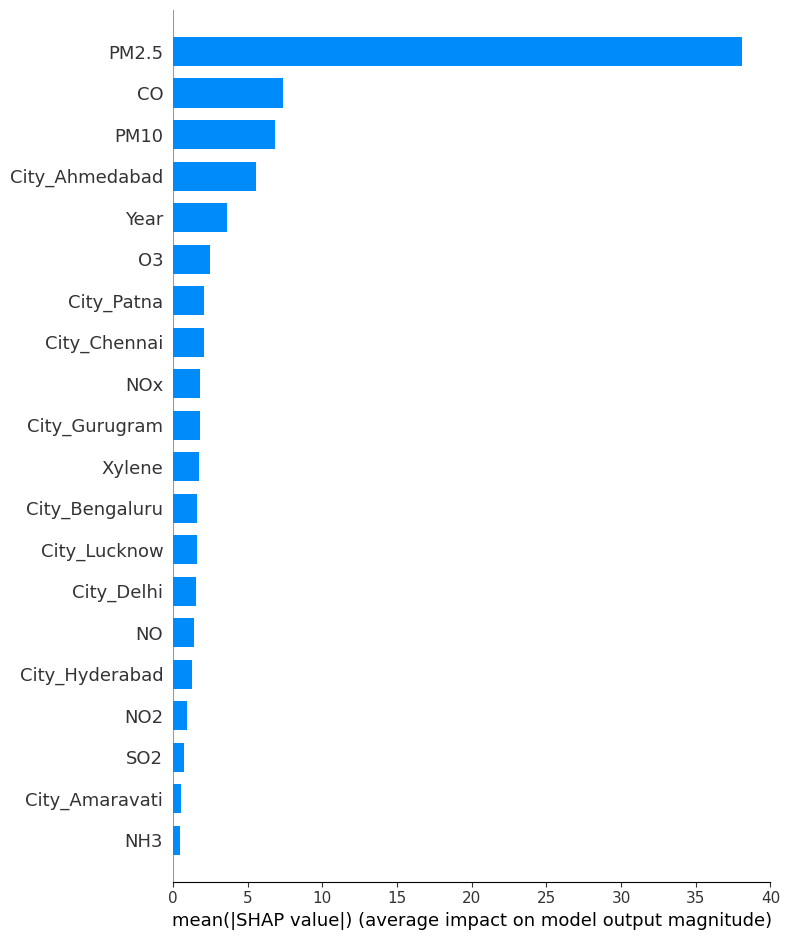

Computing LIME explanations for SVR...
Generating LIME explanation for instance 0...


GradientBoostingRegressor Model:
Train R^2 Score: 0.844
Validation R^2 Score: 0.827
Test R^2 Score: 0.845
----------------------------------------
Computing SHAP values for GradientBoostingRegressor...
Generating SHAP summary plot for GradientBoostingRegressor...


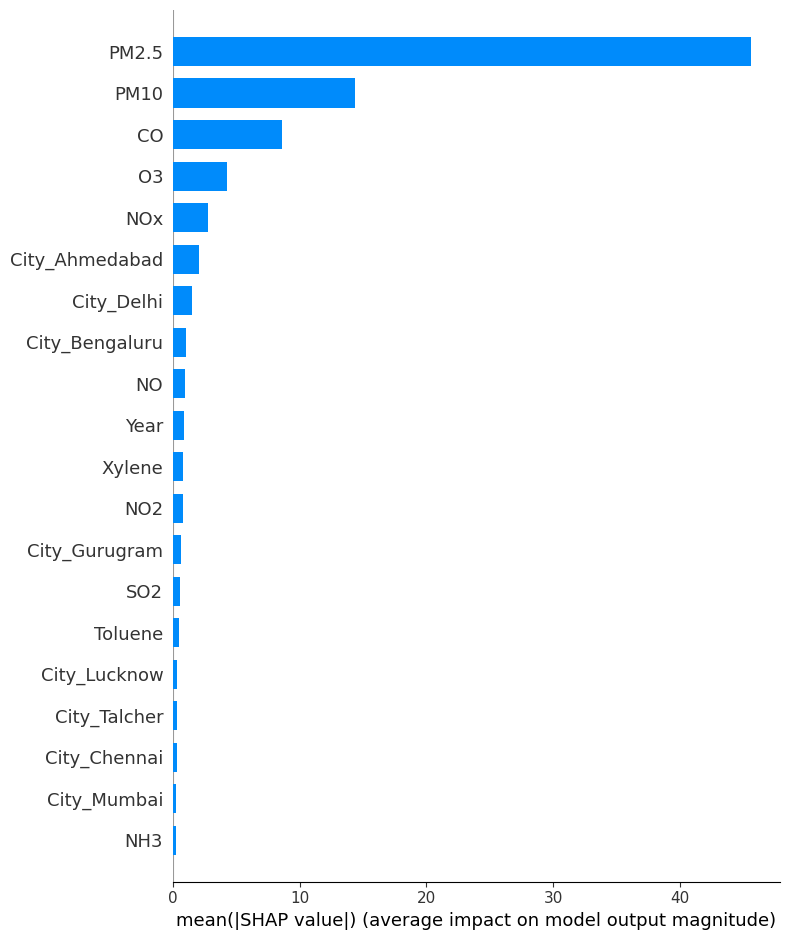

Computing LIME explanations for GradientBoostingRegressor...
Generating LIME explanation for instance 0...


XGBoost Model:
Train R^2 Score: 0.937
Validation R^2 Score: 0.842
Test R^2 Score: 0.916
----------------------------------------
Computing SHAP values for XGBoost...
Generating SHAP summary plot for XGBoost...


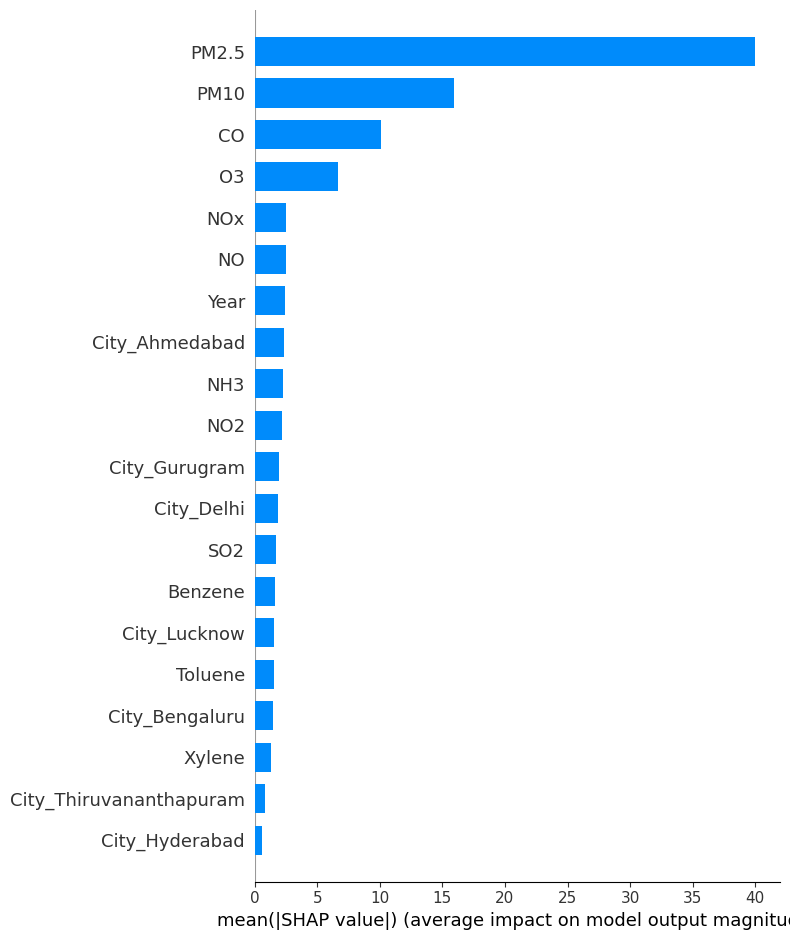

Computing LIME explanations for XGBoost...
Generating LIME explanation for instance 0...


RandomForestRegressor Model:
Train R^2 Score: 0.980
Validation R^2 Score: 0.850
Test R^2 Score: 0.952
----------------------------------------
Computing SHAP values for RandomForestRegressor...
Generating SHAP summary plot for RandomForestRegressor...


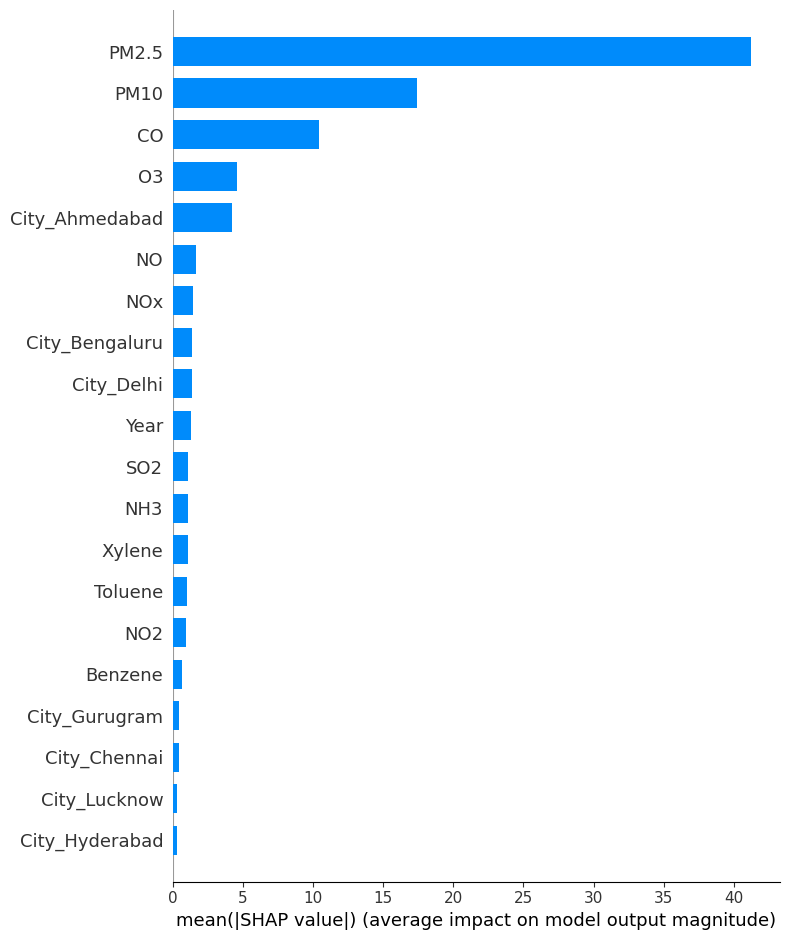

Computing LIME explanations for RandomForestRegressor...
Generating LIME explanation for instance 0...


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004711 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3117
[LightGBM] [Info] Number of data points in the train set: 19880, number of used features: 39
[LightGBM] [Info] Start training from score 146.855332
LightGBM Model:
Train R^2 Score: 0.892
Validation R^2 Score: 0.848
Test R^2 Score: 0.883
----------------------------------------
Computing SHAP values for LightGBM...
Generating SHAP summary plot for LightGBM...


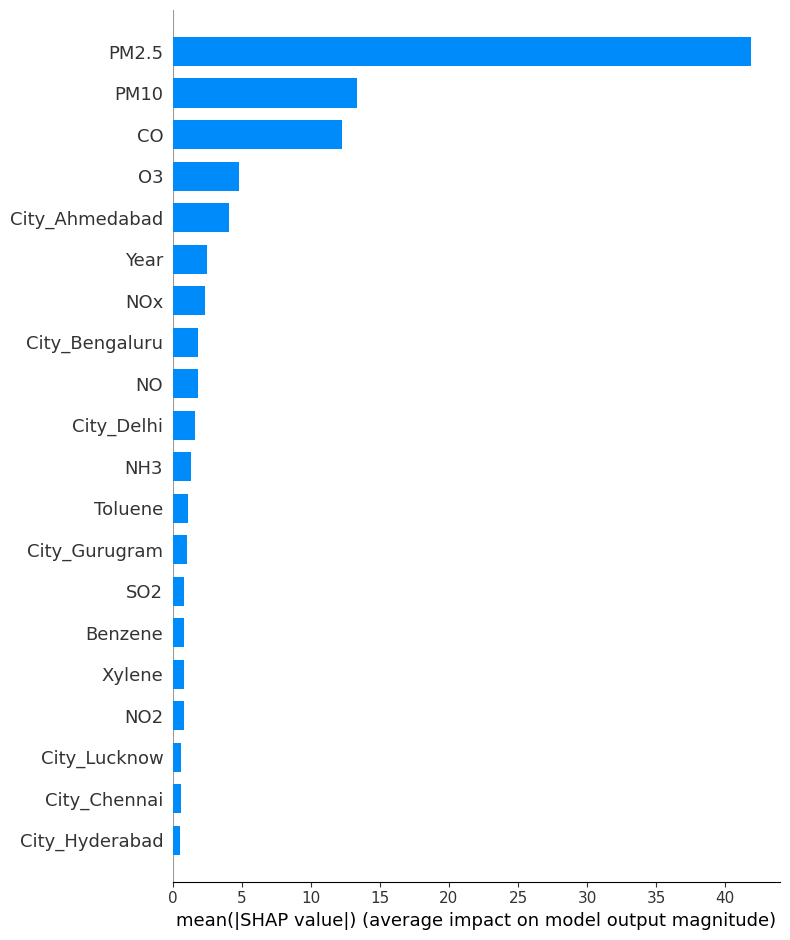

Computing LIME explanations for LightGBM...
Generating LIME explanation for instance 0...


Final Results:
                       Model  Train R^2 Score  Validation R^2 Score  \
0           LinearRegression         0.711659              0.703124   
1                      Ridge         0.711659              0.703125   
2               SGDRegressor         0.711312              0.702964   
3                 ElasticNet         0.644183              0.632727   
4                      Lasso         0.690668              0.684295   
5                        SVR         0.686724              0.678345   
6  GradientBoostingRegressor         0.844375              0.827409   
7                    XGBoost         0.936842              0.841852   
8      RandomForestRegressor         0.980491              0.850028   
9                   LightGBM         0.892086              0.847633   

   Test R^2 Score  
0        0.708505  
1        0.708505  
2        0.707926  
3        0.641636  
4        0.689288  
5        0.685713  
6        0.844596  
7        0.915677  
8        0.952184  
9  

In [ ]:
import shap
import matplotlib.pyplot as plt
from sklearn.metrics import r2_score
import xgboost as xgb
import lightgbm as lgb
from lime.lime_tabular import LimeTabularExplainer

# Dictionary of models
models = {
    'LinearRegression': LinearRegression(),
    'Ridge': Ridge(),
    'SGDRegressor': SGDRegressor(max_iter=1000, tol=1e-3, random_state=42),
    'ElasticNet': ElasticNet(random_state=42),
    'Lasso': Lasso(random_state=42),
    'SVR': SVR(kernel='linear'),
    'GradientBoostingRegressor': GradientBoostingRegressor(random_state=42),
    'XGBoost': xgb.XGBRegressor(random_state=42),
    'RandomForestRegressor': RandomForestRegressor(random_state=42),
    'LightGBM': lgb.LGBMRegressor(random_state=42)
}

# Results storage
results = []

# Function to evaluate models, compute SHAP values, and apply LIME
def try_model(model, name):
    # Fit the model
    model.fit(X_train, train_target)

    # Predictions
    train_preds = model.predict(X_train)
    val_preds = model.predict(X_val)
    test_preds = model.predict(X_test)

    # Compute R^2 scores
    train_r2_score = r2_score(train_target, train_preds)
    val_r2_score = r2_score(val_target, val_preds)
    test_r2_score = r2_score(test_target, test_preds)

    # Print R^2 scores
    print(f"{name} Model:")
    print(f"Train R^2 Score: {train_r2_score:.3f}")
    print(f"Validation R^2 Score: {val_r2_score:.3f}")
    print(f"Test R^2 Score: {test_r2_score:.3f}")
    print("-" * 40)

    # Store results
    results.append({
        'Model': name,
        'Train R^2 Score': train_r2_score,
        'Validation R^2 Score': val_r2_score,
        'Test R^2 Score': test_r2_score
    })

    # Apply SHAP for feature importance
    print(f"Computing SHAP values for {name}...")

    # Use LinearExplainer for Linear models
    if name == 'LinearRegression':
        explainer = shap.LinearExplainer(model, X_train)
    else:
        # For other models, use KernelExplainer or other appropriate explainers
        explainer = shap.Explainer(model, X_train)

    # For faster computation, sample 100 instances from the validation set
    shap_values = explainer.shap_values(X_val.sample(100))  # Sample 100 instances for faster computation

    # SHAP summary plot
    print(f"Generating SHAP summary plot for {name}...")
    shap.summary_plot(shap_values, X_val, plot_type="bar")
    plt.show()

    # Apply LIME for local interpretability
    print(f"Computing LIME explanations for {name}...")

    # Initialize LimeTabularExplainer
    lime_explainer = LimeTabularExplainer(
        training_data=X_train.values,
        feature_names=X_train.columns,
        class_names=[str(x) for x in sorted(train_target.unique())],  # For classification; modify if regression
        mode="regression"
    )

    # Choose a random instance to explain (e.g., the first instance in the validation set)
    instance_idx = 0  # You can choose another instance index if needed
    explanation = lime_explainer.explain_instance(
        X_val.iloc[instance_idx], model.predict
    )

    # LIME explanation visualization
    print(f"Generating LIME explanation for instance {instance_idx}...")
    explanation.show_in_notebook()

# Evaluate all models
for name, model in models.items():
    try_model(model, name)

# Print final results
import pandas as pd

print("Final Results:")
print(pd.DataFrame(results))


In [ ]:
%%time
from sklearn.tree import DecisionTreeRegressor, plot_tree
tree = DecisionTreeRegressor(random_state=42)
try_model(tree,name="DecisionTreeRegressor")

DecisionTreeRegressor Model:
Train r2_score :  0.9998722403606974
Validation r2_score :  0.7223730853882299
Test r2_score :  0.9363775170269288
----------------------------------------
CPU times: user 447 ms, sys: 922 µs, total: 447 ms
Wall time: 450 ms


In [ ]:
rf.feature_importances_

array([6.60984961e-01, 1.09632814e-01, 2.02242498e-02, 1.64789053e-02,
       1.37020138e-02, 9.89583230e-03, 3.25796378e-02, 1.50662242e-02,
       2.05586011e-02, 1.10280218e-02, 1.02745727e-02, 7.21283217e-03,
       8.54128155e-03, 4.70973265e-02, 2.96198123e-06, 7.18152852e-05,
       2.23222368e-04, 2.34153230e-03, 7.10653341e-05, 2.15048958e-04,
       2.57360405e-05, 1.74619343e-03, 1.44614854e-05, 5.92749250e-03,
       2.38113065e-05, 9.22160531e-04, 3.71632417e-04, 9.05615313e-04,
       3.55306642e-04, 3.44817153e-04, 2.55333575e-05, 2.35323042e-04,
       7.62420379e-04, 7.03150467e-05, 7.54627401e-04, 4.96396808e-06,
       9.92654839e-04, 8.06046762e-05, 2.33410591e-04])

In [ ]:
importance_df = pd.DataFrame({
    'feature': numeric_cols+encoded_cols,
    'importance': rf.feature_importances_
}).sort_values('importance', ascending=False)
importance_df.head(10)

,feature,importance
0,PM2.5,0.660985
1,PM10,0.109633
13,City_Ahmedabad,0.047097
6,CO,0.032580
8,O3,0.020559
2,NO,0.020224
3,NO2,0.016479
7,SO2,0.015066
4,NOx,0.013702
9,Benzene,0.011028


In [ ]:
GBR = GradientBoostingRegressor()
param_distributions = {
    'n_estimators': [50, 100, 200, 300],
    'learning_rate': [0.001, 0.01, 0.1, 0.2],
    'max_depth': [3, 4, 5, 6],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'subsample': [0.8, 0.9, 1.0]
}

In [ ]:
from sklearn.model_selection import RandomizedSearchCV
randomized_search = RandomizedSearchCV(
    estimator=GBR,
    param_distributions=param_distributions,
    n_iter=10,
    cv=5,
    verbose=1,
    n_jobs=-1,
    random_state=42
)

randomized_search.fit(X_train, train_target)


Fitting 5 folds for each of 10 candidates, totalling 50 fits


RandomizedSearchCV(cv=5, estimator=GradientBoostingRegressor(), n_jobs=-1,
                   param_distributions={'learning_rate': [0.001, 0.01, 0.1,
                                                          0.2],
                                        'max_depth': [3, 4, 5, 6],
                                        'min_samples_leaf': [1, 2, 4],
                                        'min_samples_split': [2, 5, 10],
                                        'n_estimators': [50, 100, 200, 300],
                                        'subsample': [0.8, 0.9, 1.0]},
                   random_state=42, verbose=1)

In [ ]:
best_model = randomized_search.best_estimator_
best_model.fit(X_train, train_target)
train_preds = best_model.predict(X_train)
val_preds = best_model.predict(X_val)
test_preds=best_model.predict(X_test)

train_r2_score = r2_score(train_target, train_preds)
val_r2_score= r2_score(val_target, val_preds)
test_r2_score = r2_score(test_target, test_preds)

print("Train r2_score : ", train_r2_score)
print("Validation r2_score : ", val_r2_score)
print("Test r2_score : ", test_r2_score)

Train r2_score :  0.9387186118126611
Validation r2_score :  0.8511391810896283
Test r2_score :  0.9212619589287915


In [ ]:
def predict_input(single_input):
    input_df = pd.DataFrame([single_input])
    input_df['Date'] = pd.to_datetime(input_df['Date'], format='%d-%m-%Y')
    input_df['Year'] = input_df['Date'].dt.year
    input_df[numeric_cols] = imputer.transform(input_df[numeric_cols])
    input_df[numeric_cols] = scaler.transform(input_df[numeric_cols])
    input_df[encoded_cols] = encoder.transform(input_df[categorical_cols])
    X_input = input_df[numeric_cols + encoded_cols]
    pred = best_model.predict(X_input)[0]
    return pred

In [ ]:
new_input = {'City': 'Delhi',
             'PM2.5': 23.2,
             'PM10': 33.2,
             'NO': 10.2,
             'NO2': 4.2,
             'NOx': 10.4,
             'NH3': 52.0,
             'CO': 13.0,
             'SO2': 20.0,
             'Toluene': 89.0,
             'Date': '01-01-2019',
             'O3': 20.0,
             'Benzene': 10.0,
             'Xylene': 3.4
           }

predict_input(new_input)

113.11370669425547

In [ ]:
results_df = pd.DataFrame(results)

In [ ]:
results_df

,Model,Train R2 Score,Validation R2 Score,Test R2 Score
0,LinearRegression,0.711659,0.703124,0.708505
1,Ridge,0.711659,0.703125,0.708505
2,SGDRegressor,0.710294,0.701467,0.707256
3,ElasticNet,0.644183,0.632727,0.641636
4,Lasso,0.690668,0.684295,0.689288
5,SVR,0.686724,0.678345,0.685713
6,GradientBoostingRegressor,0.844375,0.827409,0.844596
7,XGBoost,0.936842,0.841852,0.915677
8,RandomForestRegressor,0.980491,0.850028,0.952184
9,LightGBM,0.892086,0.847633,0.882648


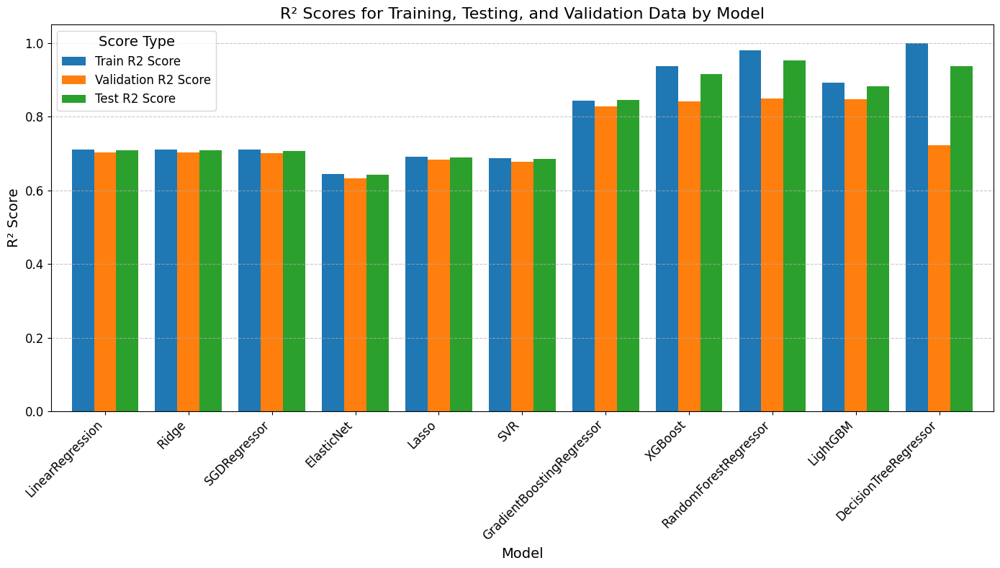

In [ ]:
# Improved bar chart for better alignment and readability
results_df.set_index('Model').plot(kind='bar', figsize=(14, 8), width=0.8)  # Increase figure size and set bar width
plt.title('R² Scores for Training, Testing, and Validation Data by Model', fontsize=16)  # Larger title for emphasis
plt.xlabel('Model', fontsize=14)  # Larger font for x-axis label
plt.ylabel('R² Score', fontsize=14)  # Larger font for y-axis label
plt.legend(title='Score Type', fontsize=12, title_fontsize=14)  # Adjust legend font sizes
plt.xticks(rotation=45, fontsize=12, ha='right')  # Rotate and align x-axis labels for better readability
plt.yticks(fontsize=12)  # Adjust y-axis font size
plt.grid(axis='y', linestyle='--', alpha=0.7)  # Add horizontal gridlines for better interpretation
plt.tight_layout()  # Ensures proper spacing for all elements
plt.show()
